In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, MinuteLocator, SecondLocator
import numpy as np
import datetime as dt

import geopandas as gpd
from shapely.geometry import Point

from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS

from sklearn.metrics.pairwise import haversine_distances

from geopy.distance import great_circle

from shapely.geometry import MultiPoint


In [2]:
from hydra import initialize, compose
from omegaconf import OmegaConf

with initialize(version_base=None, config_path="..\\scripts\\config\\"):
    cfg = compose(config_name='config.yaml')

In [45]:
locs = pd.read_csv(f"..\\data\\stupino_locs.csv")

In [ ]:
# old all
# launch_time = "2023-05-02_16-11-15" 

#60m all
# launch_time = "2023-05-05_10-08-16"

#50m all
launch_time = "2023-05-08_17-20-29"

#cur
# launch_time = "2023-05-04_20-54-38"
cluster_data = pd.read_csv(f"H:\\jupyter\\CityTraffic\data\\{launch_time}\\clusters_{launch_time}.csv")
df = pd.read_csv(f"H:\\jupyter\\CityTraffic\data\\{launch_time}\\data_with_clusters_{launch_time}.csv", index_col=0)
pd.reset_option('display.max_rows')

In [96]:
pd.unique(df['id']).shape

(21833,)

In [79]:
(df.groupby('id')['cnt'].sum().sort_values() > 50000).sum()

27

In [61]:
df['id'].value_counts()

id
4450     7015
4127     5969
416      5595
1628     5450
3209     5267
         ... 
16086       1
20800       1
20802       1
8106        1
14221       1
Name: count, Length: 21833, dtype: int64

In [36]:
cur_id = 342
# cur_id_df = active_df.query('id == @cur_id')
cur_id_df = df.query('id == @cur_id')

#sort timestamps

#maybe later?
# cur_id_df.loc[:, 'time_length'] = cur_id_df['last_ts'] - cur_id_df['first_ts'] 
# cur_id_df.loc[:, 'point_activity'] = cur_id_df['cnt'] / cur_id_df['time_length']

columns=['lat', 'lon', 'ts', 'id', 'length']
new_id_df = np.empty((0, 5))

for index, row in cur_id_df.iterrows():
    cnt = row['cnt']
    first_ts = row['first_ts']
    last_ts = row['last_ts']
    lats =  np.ones((cnt, 1)) * row['lat']
    lons =  np.ones((cnt, 1)) * row['lon']
    ids = np.ones((cnt, 1)) * cur_id
    points = np.linspace(first_ts, last_ts, cnt).reshape(((cnt, 1)))
    lengths = np.ones((cnt, 1)) * ((last_ts - first_ts) / cnt)
    values = np.hstack([lats, lons, points, ids, lengths])
    new_id_df = np.vstack([new_id_df, values])

    
new_id_df = pd.DataFrame(data=new_id_df,
        columns=columns)


In [33]:
geometry = [Point(xy) for xy in zip(cur_id_df['lon'], cur_id_df['lat'])]
gdf = gpd.GeoDataFrame(cur_id_df , geometry=geometry, crs=4326)
gdf.explore(categorical=True, column='cluster')

In [41]:
METERS_PER_RADIAN = 6371008.8
# MAX_DIST_M = cfg.max_dist / 10
# MIN_SAMPLES = cfg.min_samples * 10
MAX_DIST_M = 60
# 6 for HW and 30 for INTEREST
MIN_SAMPLES = new_id_df.shape[0] // 6

In [55]:
epsilon = MAX_DIST_M / METERS_PER_RADIAN
coords = new_id_df[['lat', 'lon']].values
db = DBSCAN(eps=epsilon, min_samples=MIN_SAMPLES, **cfg.model_params).fit(np.radians(coords))
# db = OPTICS(max_eps=epsilon, min_samples=MIN_SAMPLES, **cfg.model_params, ).fit(np.radians(coords))
new_id_df['cluster'] = db.labels_

In [56]:
new_id_df['cluster'].value_counts()

cluster
 0    28929
 1     8741
-1     1337
Name: count, dtype: int64

In [57]:
geometry = [Point(xy) for xy in zip(new_id_df['lon'], new_id_df['lat'])]
gdf = gpd.GeoDataFrame(new_id_df, geometry=geometry, crs=4326)
gdf.explore(categorical=True, column='cluster')

In [58]:
new_id_df.groupby('cluster')['length'].sum()

cluster
-1     39827.0
 0    840022.0
 1    312522.0
Name: length, dtype: float64

AFTER CLUSTERING

In [395]:
launch_time = "2023-05-12_01-05-42"
cluster_data = pd.read_csv(f"C:\\Users\\kirin\\jupyter\\CityTraffic\\data\\{launch_time}\\clusters_{launch_time}.csv")
df = pd.read_csv(f"C:\\Users\\kirin\\jupyter\\CityTraffic\\data\\{launch_time}\\data_with_clusters_{launch_time}.csv", index_col=0)
pd.reset_option('display.max_rows')

In [396]:
df['id'].unique().shape, df.shape

((1949,), (9215765, 8))

In [397]:
geometry = [Point(xy) for xy in zip(cluster_data['lon'], cluster_data['lat'])]
gdf = gpd.GeoDataFrame(cluster_data , geometry=geometry, crs=4326)
gdf.explore(categorical=True, column='home_place')

In [788]:
cur_id_test = 13666
cur_id_df = df.query('id == @cur_id_test')

geometry = [Point(xy) for xy in zip(cur_id_df['lon'], cur_id_df['lat'])]
gdf = gpd.GeoDataFrame(cur_id_df , geometry=geometry, crs=4326)
gdf.explore(categorical=True, column='cluster')

In [789]:
cluster_data_id = cluster_data.query('id == @cur_id_test')
geometry = [Point(xy) for xy in zip(cluster_data_id['lon'], cluster_data_id['lat'])]
gdf = gpd.GeoDataFrame(cluster_data_id, geometry=geometry, crs=4326)
gdf.explore(categorical=True, column="home_place", cmap= ['blue', 'green'])

### Research

Стоит попробовать нормировать данные по кластеру в день так, чтобы они начинались с 00:00

In [790]:
def sec_from_day_start(x):
    hm = pd.to_datetime(x, unit='s').dt.strftime('%H:%M:%S').str.split(':')
    return hm.apply(lambda x: 3600 * int(x[0]) + 60 * int(x[1]) + int(x[0]))

In [791]:
cur_id_df.head()

,lat,lon,ts,id,length,cluster,slot,log_date,geometry
8074097,54.8997,38.0855,1.675267e+09,13666.0,260.3,0,16.0,2023-02-01,POINT (38.08550 54.89970)
8074098,54.8997,38.0855,1.675268e+09,13666.0,260.3,0,16.0,2023-02-01,POINT (38.08550 54.89970)
8074099,54.8997,38.0855,1.675268e+09,13666.0,260.3,0,16.0,2023-02-01,POINT (38.08550 54.89970)
8074100,54.8997,38.0855,1.675268e+09,13666.0,260.3,0,16.0,2023-02-01,POINT (38.08550 54.89970)
8074101,54.8997,38.0855,1.675268e+09,13666.0,260.3,0,16.0,2023-02-01,POINT (38.08550 54.89970)


In [792]:
data = cur_id_df[(cur_id_df['cluster'] != -1) & (pd.to_datetime(cur_id_df['ts'], unit='s').dt.dayofweek < 5)].copy()
data['day_ts'] = cur_id_df['ts'] % (60 * 60 * 24)

In [793]:
gd = data.groupby('cluster')

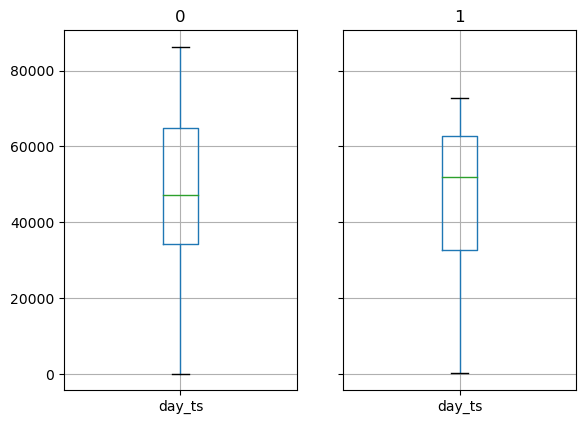

In [794]:
gd[['day_ts']].boxplot();

In [795]:
ax_list[0]

<AxesSubplot:title={'center':'0'}>

(0.0, 80000.0)

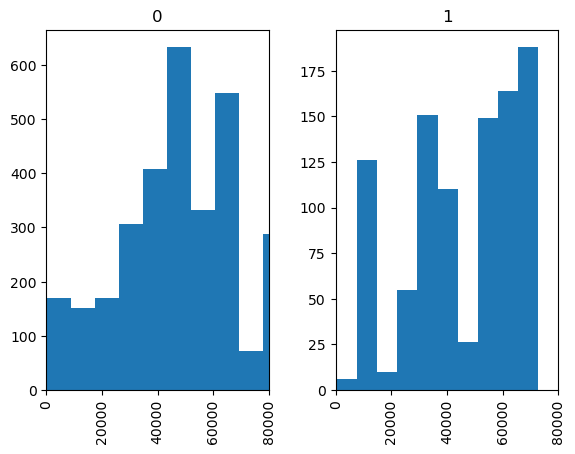

In [796]:
ax_list = data['day_ts'].hist(layout=(1,2), by=data['cluster'])
ax_list[0].set_xlim((0, 80000))
ax_list[1].set_xlim((0, 80000))


In [760]:
inq = gd[['day_ts']].agg(lambda x: np.quantile(x, 0.75)) - gd[['day_ts']].agg(lambda x: np.quantile(x, 0.25))
mm = (np.abs(gd[['day_ts']].mean() - gd[['day_ts']].median())) / (np.max([gd[['day_ts']].mean(),  gd[['day_ts']].median()]))

In [761]:
inq, mm

(               day_ts
 cluster              
 0        39935.658333
 1        18975.398809,
            day_ts
 cluster          
 0        0.129713
 1        0.032129)

In [763]:
(inq < 31000) == (mm < 0.13)

,day_ts
cluster,
0,False
1,True


NEW CLUSSIFICATION

In [855]:
#only weekday
def sec_from_day_start(x):
    hm = pd.to_datetime(x, unit='s').dt.strftime('%H:%M:%S').str.split(':')
    return hm.apply(lambda x: 3600 * int(x[0]) + 60 * int(x[1]) + int(x[0]))

THRESH_VALUE = 31000
hw_df = pd.DataFrame()
for cur_id in tqdm(ID_LIST):
    cur_id_df = df.query('id == @cur_id')
    data = cur_id_df[(cur_id_df['cluster'] != -1) & (pd.to_datetime(cur_id_df['ts'], unit='s').dt.dayofweek < 5)].copy()
    data['day_ts'] = cur_id_df['ts'] % (60 * 60 * 24)
    gd = data.groupby('cluster')
    inq = gd[['day_ts']].agg(lambda x: np.quantile(x, 0.75)) - gd[['day_ts']].agg(lambda x: np.quantile(x, 0.25))
    inq = (inq < THRESH_VALUE)['day_ts'].rename('home_place').reset_index()
    data.merge(inq, on='cluster')
    hw_df = pd.concat(hw_df, data)



NameError: name 'tqdm' is not defined